<a href="https://colab.research.google.com/github/shizhaou/PairVAE/blob/main/SAXS_SEM_solo_and_pair_PyTorch.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Importing packages needed for the notebook

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
import torch
print(torch.__version__)
import matplotlib
print(matplotlib.__version__)

2.1.0+cu121
3.7.1


In [ ]:
# Other imports
! pip install porespy==2.2.2

import os

import matplotlib.pyplot as plt
import matplotlib.cm as cm
from matplotlib.offsetbox import OffsetImage, AnnotationBbox
from matplotlib.ticker import MultipleLocator, FormatStrFormatter, AutoMinorLocator
from imutils import paths
from tqdm import tqdm
import PIL

# torch imports
import torchvision
from torchvision.io import read_image
from torch.utils.data import Dataset, DataLoader
from torchvision.transforms import v2
from torch.nn import functional as F
from torch.nn import Conv2d, ConvTranspose2d, L1Loss
from torchsummary import summary

import numpy as np
import cv2
import pandas as pd
import seaborn as sns
from scipy import interpolate
from scipy.stats import mannwhitneyu
from sklearn.preprocessing import LabelEncoder
from sklearn.cluster import KMeans
from sklearn.manifold import TSNE
from sklearn.metrics.pairwise import cosine_similarity as cos
from sympy.utilities.iterables import multiset_permutations
from sklearn.metrics import accuracy_score, f1_score,precision_score, recall_score, roc_auc_score, confusion_matrix, mean_absolute_error
from sklearn.model_selection import *
from sklearn.preprocessing import StandardScaler
from sklearn.neighbors import KernelDensity as kde
from IPython.display import Image, display
import porespy
from edt import edt

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 139.4/139.4 kB 1.8 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 3.0/3.0 MB 19.0 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 304.7/304.7 kB 37.5 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 52.4/52.4 kB 7.9 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 435.1/435.1 kB 43.4 MB/s eta 0:00:00
  Installing build dependencies ... done
  Getting requirements to build wheel ... done
  Preparing metadata (pyproject.toml) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 690.2/690.2 kB 63.5 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 23.9/23.9 MB 48.3 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.9/1.9 MB 91.5 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 10.4/10.4 MB 66.9 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.4/1.

ERROR:openpnm:PARDISO solver not installed, run `pip install pypardiso`. Otherwise, simulations will be slow. Apple M chips not supported.


# Define functions, global parameters and preprocessing

## global hyperparamters

In [ ]:
random_seed = 43
np.random.seed(random_seed)

training_batch_size = 8

# cropped image size for both saxs and sem images
saxs_imageSize = 192
sem_imageSize = 192

train_ratio = 6 / 9

# size of the latent space for both autoencoders
latent_space_num_filters = 32

# sem image without the bottom part
sem_original_x_length = 830
sem_original_y_length = 1280

# window size for adaptive thresholding
adapt_window = 15

device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

## Datasets

In [ ]:
class SAXSDataset(Dataset):
    def __init__(self, img_dir, imgSize):
        self.img_dir = img_dir
        self.imgSize = imgSize,

    def __len__(self):
        return len(self.img_dir)

    def __getitem__(self, idx):
        img_path = self.img_dir
        image = PIL.Image.open(img_path[idx]).convert('RGB')
        image = v2.Compose([v2.ToImage(), v2.Resize(self.imgSize, antialias=False), v2.ToDtype(torch.float32, scale=True)])(image)

        return image

class SEMDataset(Dataset):
    def __init__(self, img_dir, imgSize):
        self.img_dir = img_dir
        self.imgSize = imgSize

    def __len__(self):
        return len(self.img_dir)

    def __getitem__(self, idx):
        img_path = self.img_dir
        image = PIL.Image.open(img_path[idx]).convert('RGB')
        image = v2.Compose([v2.ToImage(), v2.ToDtype(torch.float32, scale=True)])(image)
        image = image[:, :sem_original_x_length, :sem_original_y_length]
        image = v2.RandomCrop(self.imgSize)(image)

        return image

In [ ]:
rng = np.random.default_rng(seed=random_seed)

sem_image_path = "/content/drive/MyDrive/TEM image datasets/2023-Sci-Adv-SAXS-SEM/SEM"
sem_image_file_list = list(paths.list_files(basePath=sem_image_path, validExts='tif'))
sem_image_file_list.sort()
sem_image_file_list = np.array(sem_image_file_list)
saxs_image_path = "/content/drive/MyDrive/TEM image datasets/2023-Sci-Adv-SAXS-SEM/SAXS"
saxs_image_file_list = list(paths.list_files(basePath=saxs_image_path, validExts='jpg'))
saxs_image_file_list.sort()
saxs_image_file_list = np.array(saxs_image_file_list)


In [ ]:
saxs_dataset = SAXSDataset(saxs_image_file_list, saxs_imageSize)
saxs_dataloader = DataLoader(saxs_dataset, batch_size=4, shuffle=False, num_workers=0)
sem_dataset = SEMDataset(sem_image_file_list, sem_imageSize)
sem_dataloader = DataLoader(sem_dataset, batch_size=4, shuffle=False, num_workers=0)

/usr/local/lib/python3.10/dist-packages/torchvision/transforms/functional.py:1603: UserWarning: The default value of the antialias parameter of all the resizing transforms (Resize(), RandomResizedCrop(), etc.) will change from None to True in v0.17, in order to be consistent across the PIL and Tensor backends. To suppress this warning, directly pass antialias=True (recommended, future default), antialias=None (current default, which means False for Tensors and True for PIL), or antialias=False (only works on Tensors - PIL will still use antialiasing). This also applies if you are using the inference transforms from the models weights: update the call to weights.transforms(antialias=True).
  warnings.warn(


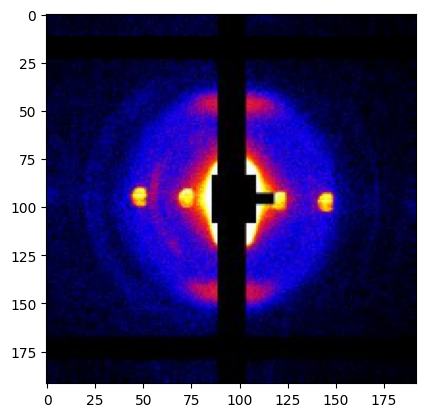

In [ ]:
for i in saxs_dataset:
  plt.imshow(i[0].permute(1, 2, 0))

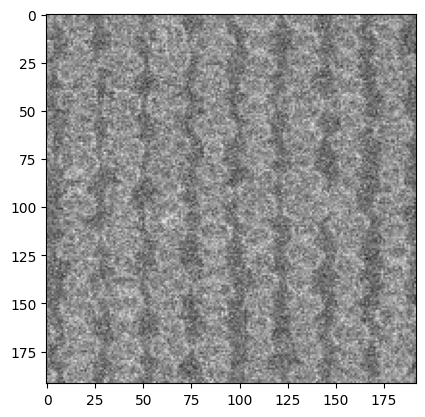

In [ ]:
for i in sem_dataset:
  plt.imshow(i.permute(1, 2, 0), cmap='gray')

## Models

In [ ]:
class SAXS_Encoder(torch.nn.Module):
    def __init__(self, num_filter, kernel_size):
        super(SAXS_Encoder, self).__init__()
        self.num_filter = num_filter
        self.kernel_size = kernel_size
        self.padding = int((self.kernel_size - 1) / 2)
        self.conv1 = Conv2d(3, self.num_filter, kernel_size=self.kernel_size, stride=2, padding=self.padding)
        self.conv2 = Conv2d(self.num_filter, self.num_filter, kernel_size=self.kernel_size, stride=2, padding=self.padding)
        self.conv3 = Conv2d(self.num_filter, self.num_filter, kernel_size=self.kernel_size, stride=2, padding=self.padding)
        self.conv4 = Conv2d(self.num_filter, self.num_filter, kernel_size=self.kernel_size, stride=2, padding=self.padding)
        self.conv5 = Conv2d(self.num_filter, self.num_filter, kernel_size=self.kernel_size, stride=2, padding=self.padding)
        self.var = Conv2d(self.num_filter, self.num_filter, kernel_size=self.kernel_size, stride=1, padding=self.padding)


    def forward(self, x):
        x = F.relu(self.conv1(x))
        x = F.relu(self.conv2(x))
        x = F.relu(self.conv3(x))
        x = F.relu(self.conv4(x))
        mu = F.relu(self.conv5(x))
        logvar = F.relu(self.var(mu))
        std = logvar.exp().pow(0.5)
        q_z = torch.distributions.normal.Normal(mu, std)
        z = q_z.rsample()

        return z, q_z

class SAXS_Decoder(torch.nn.Module):
    def __init__(self, num_filter, kernel_size):
        super(SAXS_Decoder, self).__init__()
        self.num_filter = num_filter
        self.kernel_size = kernel_size
        self.padding = int((self.kernel_size - 1) / 2)
        self.conv1 = ConvTranspose2d(self.num_filter, self.num_filter, kernel_size=self.kernel_size, stride=2, padding=self.padding, output_padding=1)
        self.conv2 = ConvTranspose2d(self.num_filter, self.num_filter, kernel_size=self.kernel_size, stride=2, padding=self.padding, output_padding=1)
        self.conv3 = ConvTranspose2d(self.num_filter, self.num_filter, kernel_size=self.kernel_size, stride=2, padding=self.padding, output_padding=1)
        self.conv4 = ConvTranspose2d(self.num_filter, self.num_filter, kernel_size=self.kernel_size, stride=2, padding=self.padding, output_padding=1)
        self.conv5 = ConvTranspose2d(self.num_filter, 3, kernel_size=self.kernel_size, stride=2, padding=self.padding, output_padding=1)


    def forward(self, x):
        x = F.relu(self.conv1(x))
        x = F.relu(self.conv2(x))
        x = F.relu(self.conv3(x))
        x = F.relu(self.conv4(x))
        x = F.relu(self.conv5(x))
        return x

class SEM_Encoder(torch.nn.Module):
    def __init__(self, num_filter, kernel_size):
        super(SEM_Encoder, self).__init__()
        self.num_filter = num_filter
        self.kernel_size = kernel_size
        self.padding = int((self.kernel_size - 1) / 2)
        self.conv1 = Conv2d(3, self.num_filter, kernel_size=self.kernel_size, stride=2, padding=self.padding)
        self.conv2 = Conv2d(self.num_filter, self.num_filter, kernel_size=self.kernel_size, stride=2, padding=self.padding)
        self.conv3 = Conv2d(self.num_filter, self.num_filter, kernel_size=self.kernel_size, stride=2, padding=self.padding)
        self.conv4 = Conv2d(self.num_filter, self.num_filter, kernel_size=self.kernel_size, stride=2, padding=self.padding)
        self.conv5 = Conv2d(self.num_filter, self.num_filter, kernel_size=self.kernel_size, stride=2, padding=self.padding)
        self.var = Conv2d(self.num_filter, self.num_filter, kernel_size=self.kernel_size, stride=1, padding=self.padding)


    def forward(self, x):
        x = F.relu(self.conv1(x))
        x = F.relu(self.conv2(x))
        x = F.relu(self.conv3(x))
        x = F.relu(self.conv4(x))
        mu = F.relu(self.conv5(x))
        logvar = F.relu(self.var(mu))
        std = logvar.exp().pow(0.5)
        q_z = torch.distributions.normal.Normal(mu, std)
        z = q_z.rsample()

        return z, q_z

class SEM_Decoder(torch.nn.Module):
    def __init__(self, num_filter, kernel_size):
        super(SEM_Decoder, self).__init__()
        self.num_filter = num_filter
        self.kernel_size = kernel_size
        self.padding = int((self.kernel_size - 1) / 2)
        self.conv1 = ConvTranspose2d(self.num_filter, self.num_filter, kernel_size=self.kernel_size, stride=2, padding=self.padding, output_padding=1)
        self.conv2 = ConvTranspose2d(self.num_filter, self.num_filter, kernel_size=self.kernel_size, stride=2, padding=self.padding, output_padding=1)
        self.conv3 = ConvTranspose2d(self.num_filter, self.num_filter, kernel_size=self.kernel_size, stride=2, padding=self.padding, output_padding=1)
        self.conv4 = ConvTranspose2d(self.num_filter, self.num_filter, kernel_size=self.kernel_size, stride=2, padding=self.padding, output_padding=1)
        self.conv5 = ConvTranspose2d(self.num_filter, 3, kernel_size=self.kernel_size, stride=2, padding=self.padding, output_padding=1)


    def forward(self, x):
        x = F.relu(self.conv1(x))
        x = F.relu(self.conv2(x))
        x = F.relu(self.conv3(x))
        x = F.relu(self.conv4(x))
        x = F.relu(self.conv5(x))
        return x

In [ ]:
saxs_encoder = SAXS_Encoder(num_filter=32, kernel_size=5).to(device)
saxs_decoder = SAXS_Decoder(num_filter=32, kernel_size=5).to(device)
sem_encoder = SEM_Encoder(num_filter=32, kernel_size=5).to(device)
sem_decoder = SEM_Decoder(num_filter=32, kernel_size=5).to(device)

In [ ]:
criterion = L1Loss()
optimizer = torch.optim.Adam(list(saxs_encoder.parameters()) + list(saxs_decoder.parameters()), lr=1e-3)
num_epochs = 500
kl_weight = 1e-3

In [ ]:
def VAE_loss_function(input, reconstruction, q_z, kl_weight):
  recon_loss = F.l1_loss(input, reconstruction, reduction='sum')
  p_z = torch.distributions.normal.Normal(torch.zeros_like(q_z.loc), torch.ones_like(q_z.scale))
  kl_loss = torch.distributions.kl_divergence(p_z, q_z).sum()

  return recon_loss + kl_loss * kl_weight

In [ ]:
for epoch in range(num_epochs):
  train_loss = 0.0
  saxs_encoder.train()
  saxs_decoder.train()

  for input in saxs_dataloader:
    input = input.to(device)
    optimizer.zero_grad()
    sampled_latents, q_z = saxs_encoder(input)
    reconstruction = saxs_decoder(sampled_latents)
    loss = VAE_loss_function(input, reconstruction, q_z, kl_weight)
    loss.backward()
    optimizer.step()

    train_loss += loss.item() * input.size(0)

  print('====> Epoch: {} Average loss: {:.4f}'.format(
          epoch, train_loss / len(saxs_dataloader.dataset)))

====> Epoch: 0 Average loss: 46328.2033
====> Epoch: 1 Average loss: 35787.9388
====> Epoch: 2 Average loss: 33455.9364
====> Epoch: 3 Average loss: 31262.7807
====> Epoch: 4 Average loss: 29248.0056
====> Epoch: 5 Average loss: 27701.6071
====> Epoch: 6 Average loss: 26408.2988
====> Epoch: 7 Average loss: 24562.1966
====> Epoch: 8 Average loss: 23430.5539
====> Epoch: 9 Average loss: 23216.1118
====> Epoch: 10 Average loss: 23795.0920
====> Epoch: 11 Average loss: 22020.7466
====> Epoch: 12 Average loss: 20623.6606
====> Epoch: 13 Average loss: 19480.1623
====> Epoch: 14 Average loss: 19025.0934
====> Epoch: 15 Average loss: 19448.7508
====> Epoch: 16 Average loss: 19989.3073
====> Epoch: 17 Average loss: 17950.9653
====> Epoch: 18 Average loss: 16720.8262
====> Epoch: 19 Average loss: 16312.0173
====> Epoch: 20 Average loss: 15948.7510
====> Epoch: 21 Average loss: 16139.0315
====> Epoch: 22 Average loss: 17125.3404
====> Epoch: 23 Average loss: 16077.2675
====> Epoch: 24 Average lo

<ipython-input-192-1a81cbd92783>:5: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  plt.figure()


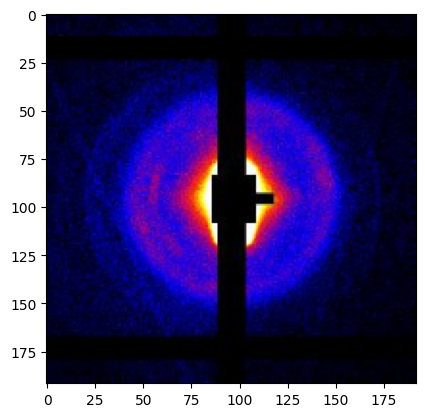

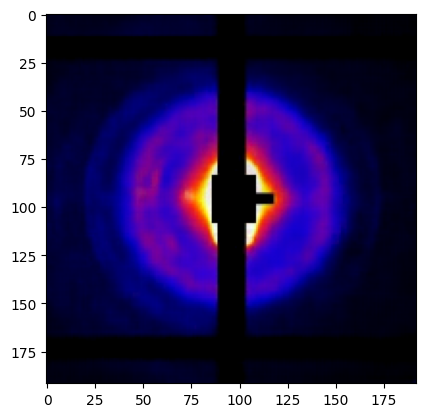

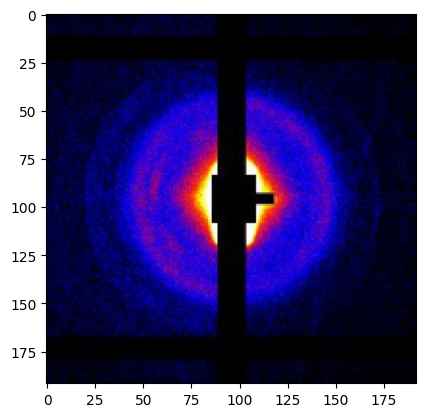

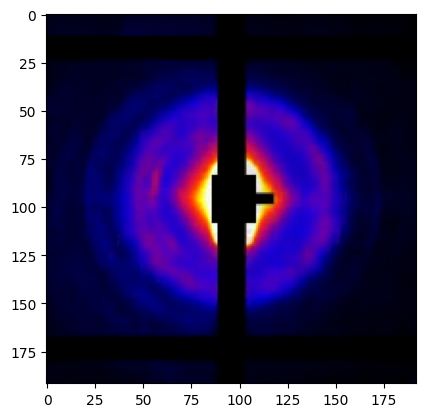

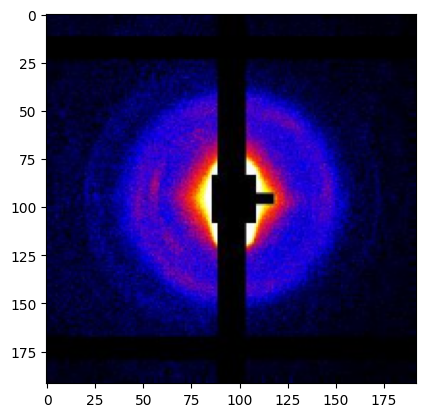

...

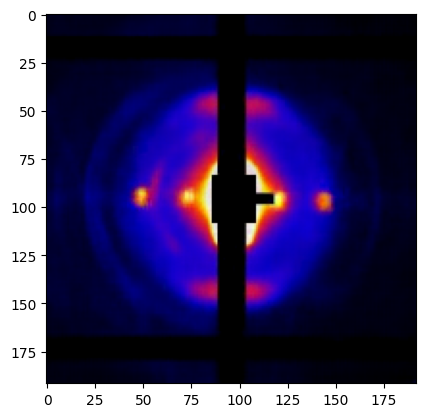

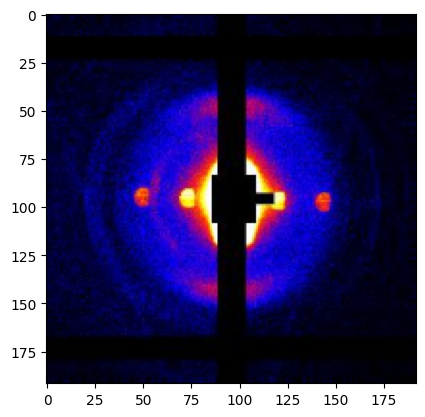

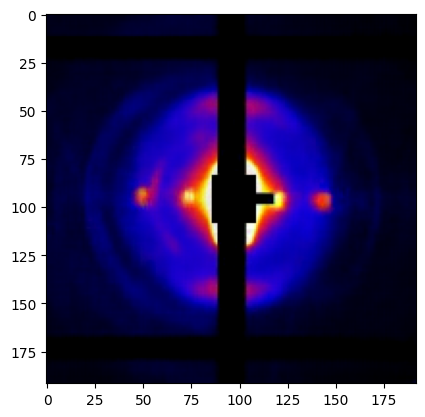

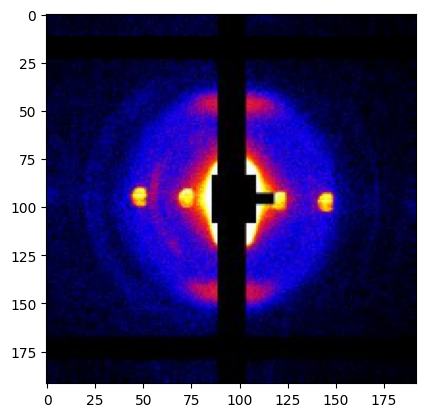

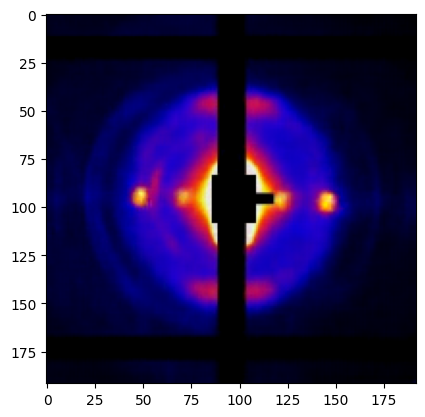

In [ ]:
  saxs_encoder.eval()
  saxs_decoder.eval()

  for i in saxs_dataset:
    plt.figure()
    plt.imshow(i.permute(1, 2, 0).detach().numpy())
    i = i.to(device)
    encoded_latents, q_z = saxs_encoder(i)
    reconstruction = saxs_decoder(encoded_latents).cpu()
    plt.figure()
    plt.imshow(reconstruction.permute(1, 2, 0).detach().numpy())

In [ ]:
criterion = L1Loss()
optimizer = torch.optim.Adam(list(saxs_encoder.parameters()) + list(saxs_decoder.parameters()), lr=1e-1)
num_epochs = 500
kl_weight = 1e-5

In [ ]:
for epoch in range(num_epochs):
  train_loss = 0.0
  sem_encoder.train()
  sem_decoder.train()

  for input in sem_dataloader:
    input = input.to(device)
    optimizer.zero_grad()
    sampled_latents, q_z = sem_encoder(input)
    reconstruction = sem_decoder(sampled_latents)
    loss = VAE_loss_function(input, reconstruction, q_z, kl_weight)
    loss.backward()
    optimizer.step()

    train_loss += loss.item() * input.size(0)

  print('====> Epoch: {} Average loss: {:.4f}'.format(
          epoch, train_loss / len(sem_dataloader.dataset)))

====> Epoch: 0 Average loss: 202119.4236
====> Epoch: 1 Average loss: 201102.9696
====> Epoch: 2 Average loss: 201496.5469
====> Epoch: 3 Average loss: 200333.8420
====> Epoch: 4 Average loss: 202210.1719
====> Epoch: 5 Average loss: 200620.4731
====> Epoch: 6 Average loss: 200516.0885
====> Epoch: 7 Average loss: 202699.6354
====> Epoch: 8 Average loss: 202935.9427
====> Epoch: 9 Average loss: 202048.6797
====> Epoch: 10 Average loss: 200565.8924
====> Epoch: 11 Average loss: 201424.2387
====> Epoch: 12 Average loss: 201088.6085
====> Epoch: 13 Average loss: 200022.9028
====> Epoch: 14 Average loss: 203430.9453
====> Epoch: 15 Average loss: 200735.4983
====> Epoch: 16 Average loss: 198767.8064
====> Epoch: 17 Average loss: 201111.5339
====> Epoch: 18 Average loss: 203026.1780
====> Epoch: 19 Average loss: 202202.6918
====> Epoch: 20 Average loss: 203022.0885
====> Epoch: 21 Average loss: 201203.5885
====> Epoch: 22 Average loss: 199062.1120
====> Epoch: 23 Average loss: 202486.2760
==

<ipython-input-202-9c1ad80b045a>:5: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  plt.figure()


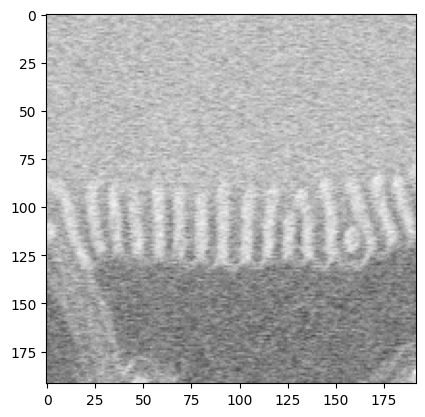

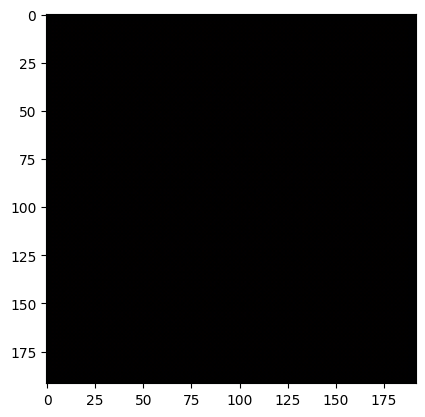

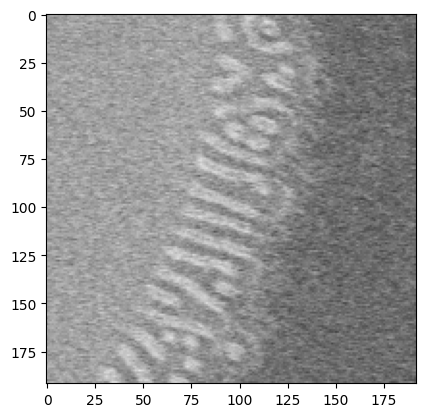

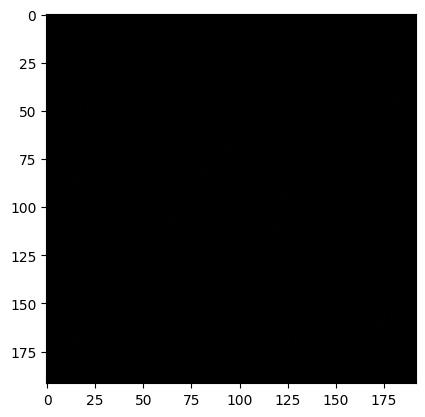

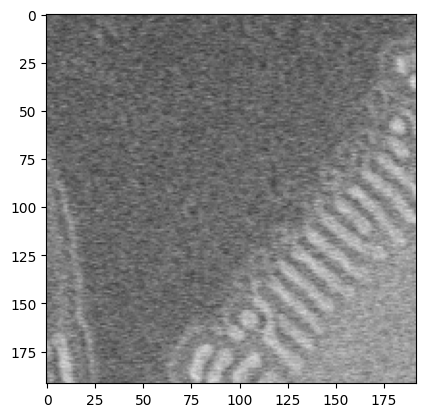

...

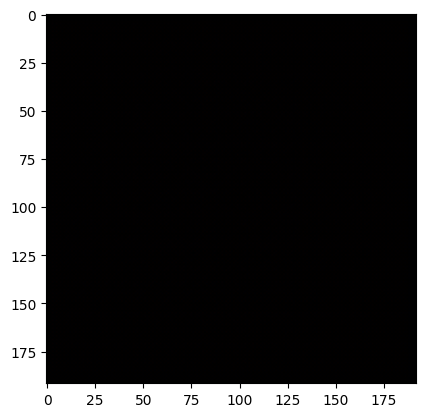

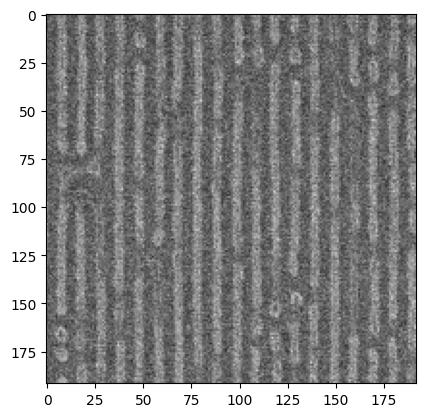

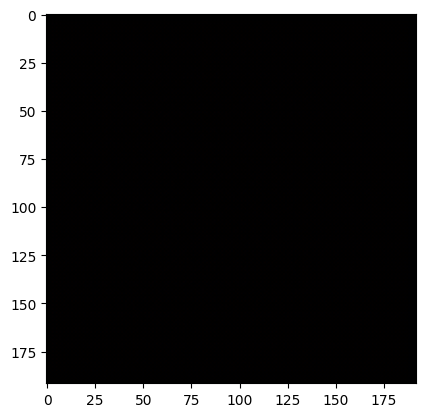

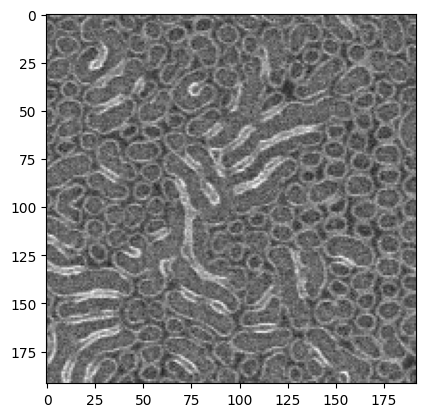

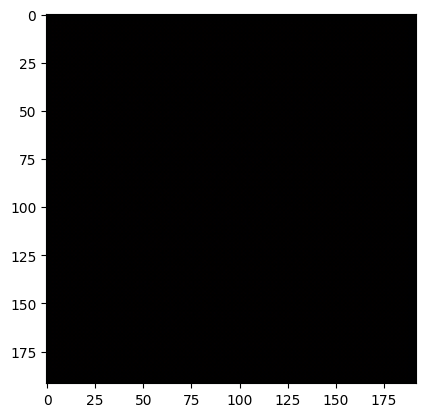

Error in callback <function flush_figures at 0x7ce5b8cfa050> (for post_execute):


KeyboardInterrupt: 

In [ ]:
  sem_encoder.eval()
  sem_decoder.eval()

  for i in sem_dataset:
    plt.figure()
    plt.imshow(i.permute(1, 2, 0).detach().numpy())
    i = i.to(device)
    encoded_latents, q_z = sem_encoder(i)
    reconstruction = sem_decoder(encoded_latents).cpu()
    plt.figure()
    plt.imshow(reconstruction.permute(1, 2, 0).detach().numpy())